In [1]:
%pylab notebook
%matplotlib notebook
import os, glob
import numpy as np
from matplotlib.pyplot import imshow
import matplotlib.pyplot as plt
import exifread
import rawpy

Populating the interactive namespace from numpy and matplotlib


In [2]:
path1 = '../astrophotography_data/MilkyWayPrettyBoy/12800/'
path2 = '../astrophotography_data/MilkyWayPrettyBoy/6400/'

In [3]:
# Combine darks from list, using a provided numpy averaging function.
def combine_arrays(file_list, combination_function=np.average):
    stack = None
    for fname, i in zip(file_list, range(len(file_list))):

        raw = rawpy.imread(fname)
        array = raw.raw_image

        if stack is None:            
            stack = np.zeros(shape=(array.shape[0],array.shape[1],len(file_list)), dtype=float)

        stack[:,:,i] = array

    return combination_function(stack, axis=2)

In [4]:
def process(path, title, vmin=500, vmax=523, combination_function=np.average):
    list_p = glob.glob(path + '/*.ARW')

    # get exposure time
    f = open(list_p[0], 'rb')
    tags = exifread.process_file(f)
    exptime = str(tags['EXIF ExposureTime'])    
    
    combined_array = combine_arrays(list_p, combination_function=combination_function)

    plt.figure(figsize=[10, 6])
    plt.imshow(combined_array, vmin=vmin, vmax=vmax)
    plt.colorbar()
    plt.title(title + " " + exptime)

<IPython.core.display.Javascript object>


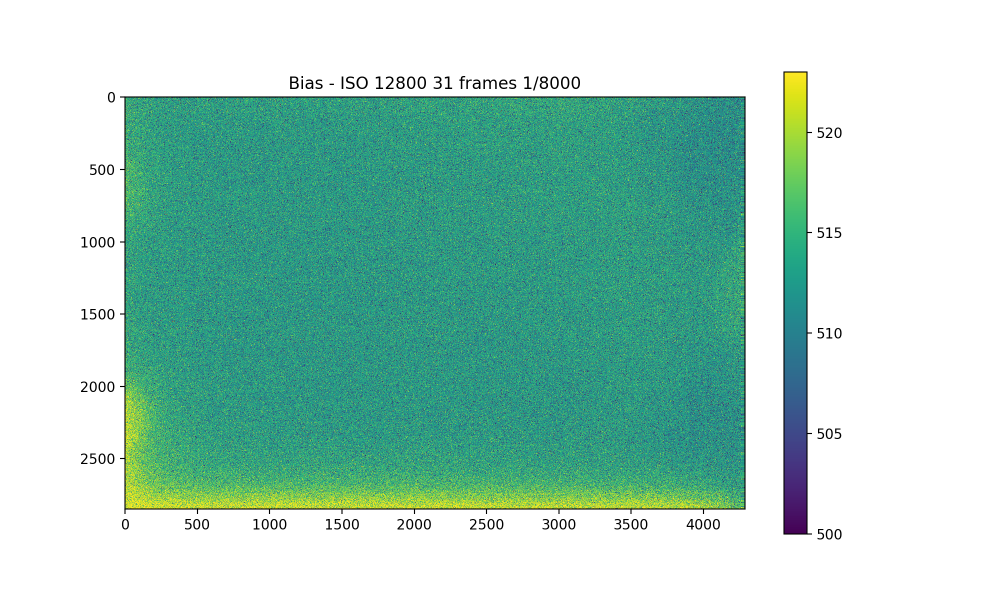

In [5]:
bias_path = os.path.join(path1,'bias')
process(bias_path, 'Bias - ISO 12800 31 frames')

<IPython.core.display.Javascript object>


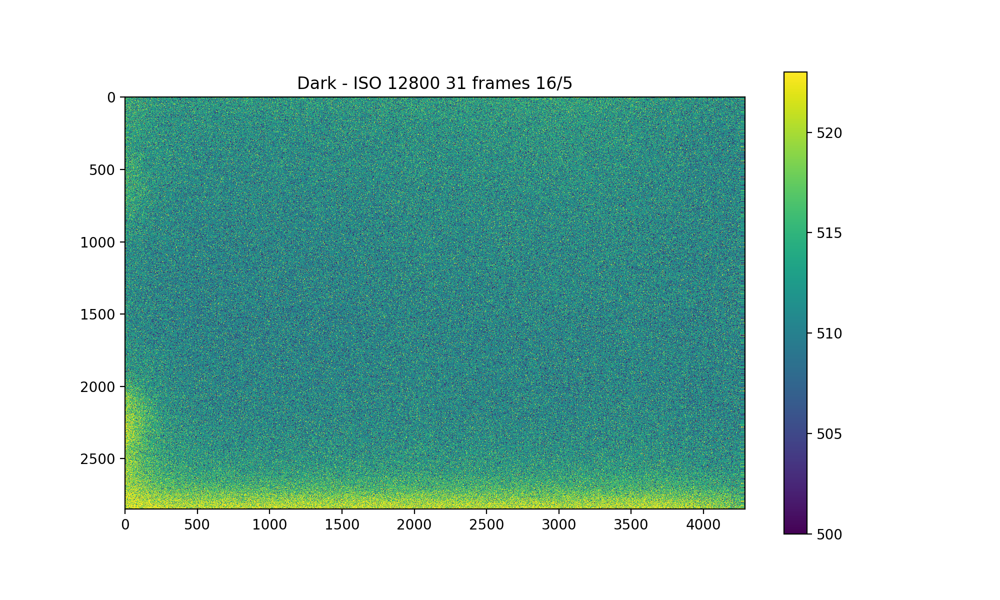

In [6]:
dark_path = os.path.join(path1,'dark')
process(dark_path, 'Dark - ISO 12800 31 frames')

<IPython.core.display.Javascript object>


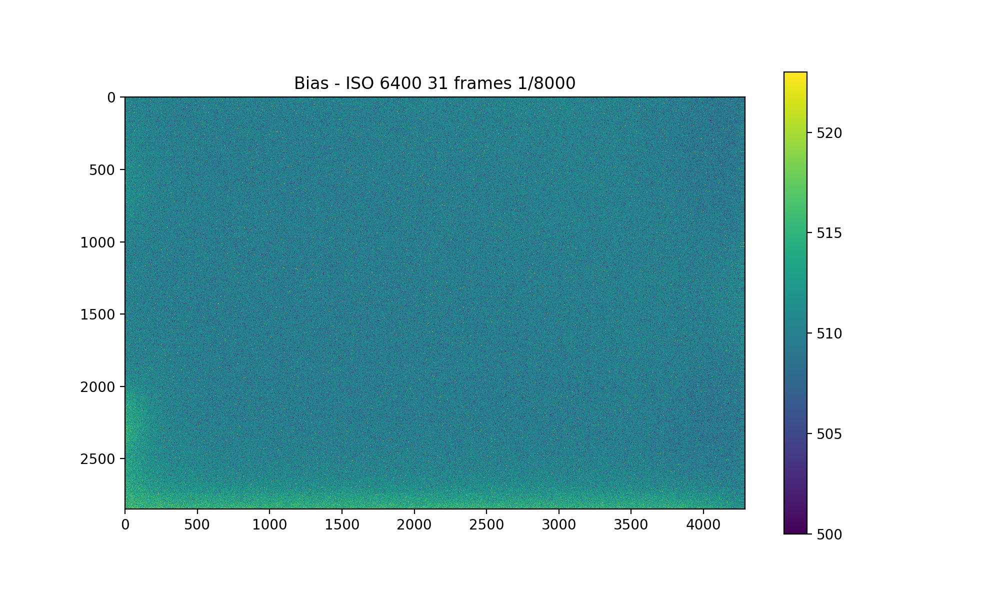

In [7]:
bias_path = os.path.join(path2,'bias')
process(bias_path, 'Bias - ISO 6400 31 frames')

<IPython.core.display.Javascript object>


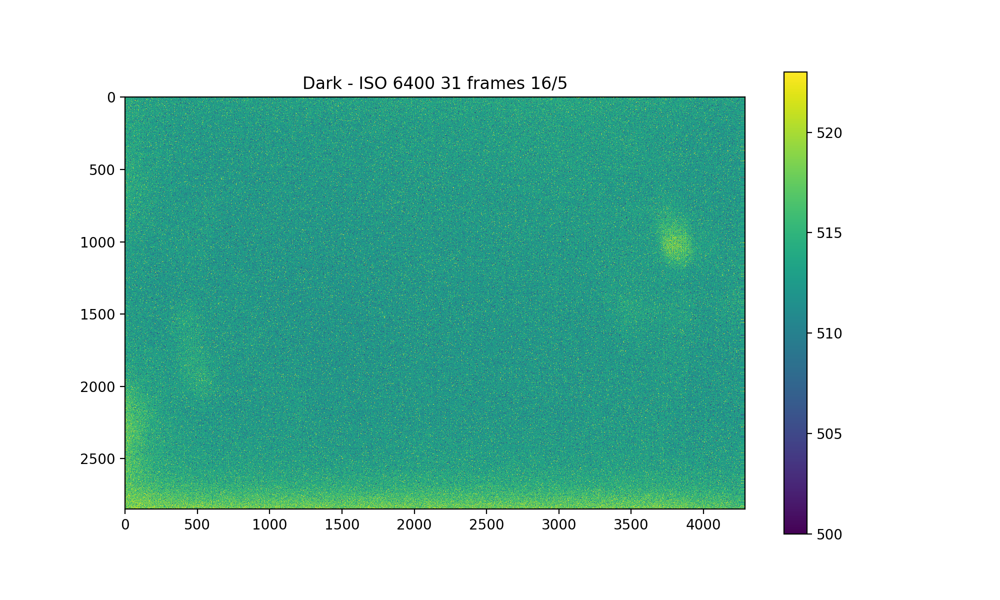

In [8]:
dark_path = os.path.join(path2,'dark')
process(dark_path, 'Dark - ISO 6400 31 frames')

<IPython.core.display.Javascript object>


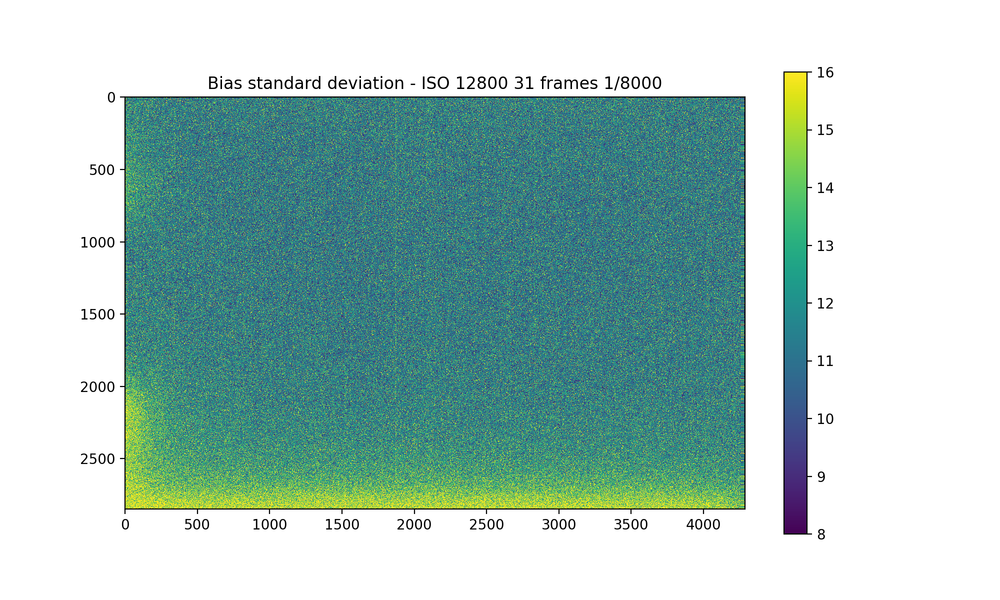

In [9]:
bias_path = os.path.join(path1,'bias')
process(bias_path, 'Bias standard deviation - ISO 12800 31 frames', vmin=8, vmax=16, combination_function=np.std)

<IPython.core.display.Javascript object>


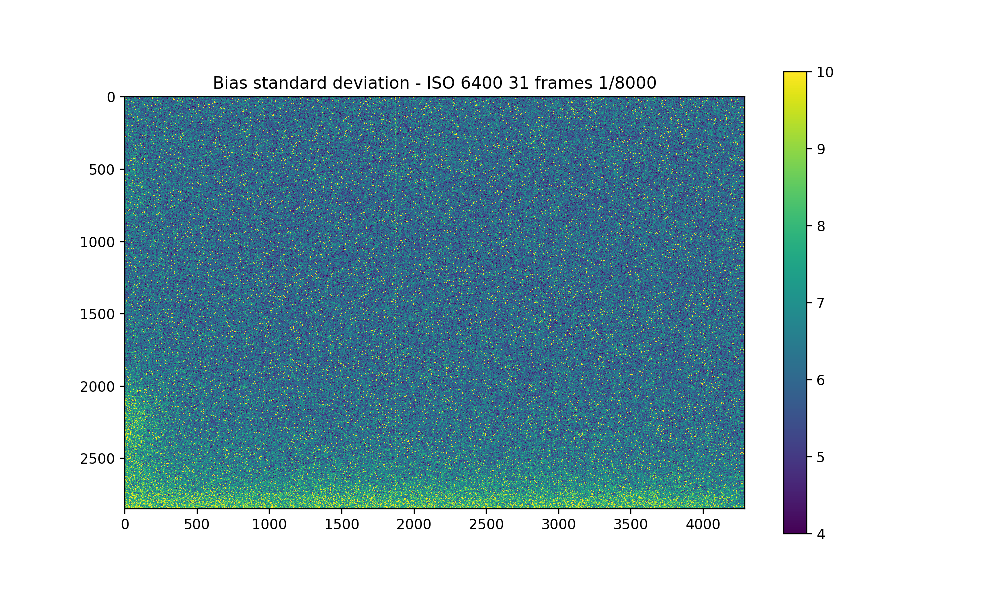

In [10]:
bias_path = os.path.join(path2,'bias')
process(bias_path, 'Bias standard deviation - ISO 6400 31 frames', vmin=4, vmax=10, combination_function=np.std)